In [1]:
import projet.processing as process                         # Contient les fonctions pour le processing de la dataframe

folder = "./data/json/"                                     # Pour écupèrer tous les fichiers json dans le dossier 'data/json/'

full_df = process.tweet_json_to_df(folder=folder, verbose=True) 

La conversion des fichiers 'json' a commencé, cela peut prendre du temps
File 1/9: [------------------>] 100 %
File 2/9: [------------------>] 100 %
File 3/9: [------------------>] 100 %
File 4/9: [------------------>] 100 %
File 5/9: [------------------>] 100 %
File 6/9: [------------------>] 100 %
File 7/9: [------------------>] 100 %
File 8/9: [------------------>] 100 %
File 9/9: [------------------>] 100 %


In [2]:
df = process.clean_df(full_df, index="id", date="created_at", verbose=True)

Le nettoyage a commencé
Progress: [------------------->] 100 %


In [4]:
process.get_full_text(df, new_var="full_text", drop_vars=True)
print("")

In [5]:
process.add_politics(df)
print("")

In [7]:
df[["full_text", "full_text-contains_trump", "full_text-contains_biden"]].head()

,full_text,full_text-contains_trump,full_text-contains_biden
id,,,
1336989688167587848,I’m telling President @realDonaldTrump to stri...,True,False
1336989688154869760,The fact that most GOP leaders don't condemn a...,False,False
1336989688565964801,I love democracy.\n\nSo fuck Trump. And fuck m...,True,False
1336989688612220928,@Thinkingifree17 @llgraves @AngelaBelcamino @r...,True,False
1336989688612212736,So evil! And he admitted the purpose of releas...,True,False


In [ ]:
process.add_sentiment(df)

In [ ]:
df["full_textAjout-sentiment-compound"].plot.hist()

In [ ]:
process.sentiment_class(df)

In [ ]:
process.add_label(df)

In [ ]:
df.head()

In [32]:
import pandas as pd
import us
states = us.STATES
urls = [state.shapefile_urls('state') for state in states]

In [35]:
us.states.MD.name

'Maryland'

In [36]:
urls

['https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_01_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_02_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_04_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_05_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_06_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_08_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_09_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_10_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_12_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_13_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_15_state10.zip',
 'https://www2.census.gov/geo/tiger/TIGER2010/STATE/2010/tl_2010_16_state10.zip',
 'https://www2.c

In [17]:
gdf = pd.concat([gpd.read_file(url) for url in urls]).pipe(gpd.GeoDataFrame)

In [18]:
gdf.head()

,REGION10,DIVISION10,STATEFP10,STATENS10,GEOID10,STUSPS10,NAME10,LSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,geometry
0,3,6,01,01779775,01,AL,Alabama,00,G4000,A,131170787086,4596557530,+32.7396323,-086.8434593,"POLYGON ((-86.31127 34.99110, -86.30899 34.991..."
0,4,9,02,01785533,02,AK,Alaska,00,G4000,A,1477953211577,245383480336,+63.3461910,-152.8370679,"MULTIPOLYGON (((177.44593 52.11133, 177.44302 ..."
0,4,8,04,01779777,04,AZ,Arizona,00,G4000,A,294207314414,1026196264,+34.2099643,-111.6024010,"POLYGON ((-109.04761 32.42638, -109.04762 32.4..."
0,3,7,05,00068085,05,AR,Arkansas,00,G4000,A,134771261408,2960539257,+34.8955256,-092.4446262,"POLYGON ((-94.55218 36.10224, -94.55219 36.102..."
0,4,9,06,01779778,06,CA,California,00,G4000,A,403466310059,20501110720,+37.1485730,-119.5406515,"MULTIPOLYGON (((-119.00093 33.53589, -119.0009..."


In [19]:
gdf.shape

(50, 15)

<AxesSubplot:>

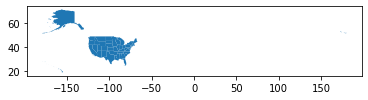

In [20]:
gdf.plot()

In [1]:
from geotext import GeoText
from geopy.geocoders import Nominatim
from geopy.exc import GeocoderTimedOut

In [21]:
text = "New York, NYC, USA and Austin, Texas, United States of America"
places = GeoText(text)

In [23]:
print(places.cities)

['New York', 'Austin', 'Texas']


In [28]:
geolocator = Nominatim(timeout=2, user_agent="projet-python-twitter")
lat_lon = []
for city in places.cities:
    try:
        loc = geolocator.geocode(city, language="en-US")
        if loc:
            print(city, loc.latitude, loc.longitude)
            lat_lon.append(loc)
    except GeocoderTimedOut as e:
        print("Error: geocode failed on input %s with message %s"(city, e))

lat_lon

New York 40.7127281 -74.0060152
Austin 30.2711286 -97.7436995
Texas 31.8160381 -99.5120986


[Location(New York, Stone Street Historic District, New York, United States, (40.7127281, -74.0060152, 0.0)),
 Location(Austin, Travis County, Texas, United States, (30.2711286, -97.7436995, 0.0)),
 Location(Texas, United States, (31.8160381, -99.5120986, 0.0))]

In [48]:
import re
# a=re.search(",?(*), United States", lat_lon[0].address)
a = re.findall("<*>", "<h1>")
a

error: nothing to repeat at position 2